In [2]:
import anndata
import scvelo as scv
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
import scanpy as sc
import glob, os
import matplotlib.pyplot as plt
from matplotlib import cm
from matplotlib.colors import ListedColormap, LinearSegmentedColormap
import matplotlib.colors
import pickle
import torch
from veloproj import *

ModuleNotFoundError: No module named 'anndata'

## plot velocity gene

In [3]:
#plot_genes = ['ITGB8', 'ARID3B', 'SHH', 'ARNTL', 'TBXT', 'SLIT2', 'NEDD9', 'SEMA3A', 'SEMA3E', 'SEMA6A', 'SEMA3C', 'CD109']
plot_genes = ['CREB3L2', 'ARID3B', 'COL2A1', 'ACAN', 'LAMB1']
sample = 'day7'
input_file = '/home/linxy29/holab/iPSC/veloAE/' + sample + '_seurate_wTrajectory.h5ad'
#input_file = '/home/linxy29/holab/iPSC/veloAE/' + sample + '_seurate_wTrajectory.h5ad'
adata = sc.read_h5ad(input_file)
adata

AnnData object with n_obs × n_vars = 9246 × 2000
    obs: 'batch', 'seurat_clusters', 'initial_size_spliced', 'initial_size_unspliced', 'initial_size', 'n_counts', 'stc_velocity_self_transition', 'stc_velocity_length', 'stc_velocity_confidence', 'stc_velocity_confidence_transition'
    var: 'Accession', 'Chromosome', 'End', 'Start', 'Strand', 'gene_count_corr', 'means', 'dispersions', 'dispersions_norm', 'highly_variable', 'stc_velocity_gamma', 'stc_velocity_qreg_ratio', 'stc_velocity_r2', 'stc_velocity_genes', 'fit_r2', 'fit_alpha', 'fit_beta', 'fit_gamma', 'fit_t_', 'fit_scaling', 'fit_std_u', 'fit_std_s', 'fit_likelihood', 'fit_u0', 'fit_s0', 'fit_pval_steady', 'fit_steady_u', 'fit_steady_s', 'fit_variance', 'fit_alignment_scaling'
    uns: 'neighbors', 'pca', 'recover_dynamics', 'seurat_clusters_colors', 'stc_velocity_graph', 'stc_velocity_graph_neg', 'stc_velocity_params'
    obsm: 'X_pca', 'X_umap', 'stc_velocity_umap'
    varm: 'PCs', 'loss'
    layers: 'Ms', 'Mu', 'ambiguous', 

In [4]:
unsplicedDF = adata.to_df(layer="unspliced")
unsplicedDF['UMAP1'] = adata.obsm['X_umap'][:,0]
unsplicedDF['UMAP2'] = adata.obsm['X_umap'][:,1]
unsplicedDF

Gene,HES4,MXRA8,ENO1,MIR34AHG,FBXO2,NPPB,DHRS3,IFFO2,CAMK2N1,HSPG2,...,GYG2P1,UTY,RPS4Y1,TBL1Y,USP9Y,DDX3Y,NLGN4Y,EIF1AY,UMAP1,UMAP2
AAACCCAAGCCGATCC-1,0.305616,0.0,0.0,0.000000,0.0,0.0,0.000000,0.305616,0.0,0.000000,...,0.0,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,0.0,0.153307,-7.623546
AAACCCAAGTACAGCG-1,0.000000,0.0,0.0,0.000000,0.0,0.0,0.000000,0.000000,0.0,0.000000,...,0.0,0.000000,0.0,0.957528,0.957528,0.000000,0.000000,0.0,5.897146,2.633477
AAACCCAGTGCTGATT-1,0.000000,0.0,0.0,0.000000,0.0,0.0,0.000000,0.000000,0.0,0.000000,...,0.0,0.000000,0.0,1.582080,0.000000,0.000000,0.000000,0.0,-5.536019,-6.625185
AAACCCAGTTTGGCTA-1,0.000000,0.0,0.0,0.873400,0.0,0.0,0.000000,0.000000,0.0,0.000000,...,0.0,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,0.0,-7.391526,-0.720508
AAACCCATCACTTGGA-1,0.000000,0.0,0.0,1.671909,0.0,0.0,0.000000,0.000000,0.0,0.000000,...,0.0,0.417977,0.0,0.835954,0.000000,0.835954,1.671909,0.0,-2.355847,-5.528623
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
TTTGTTGCATCTCAAG-1,0.000000,0.0,0.0,0.000000,0.0,0.0,1.136875,0.000000,0.0,0.757917,...,0.0,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,0.0,-7.269804,-1.790855
TTTGTTGGTAGACGTG-1,0.000000,0.0,0.0,0.000000,0.0,0.0,0.000000,0.000000,0.0,0.000000,...,0.0,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,0.0,-1.424601,-6.192325
TTTGTTGGTGAGCGAT-1,0.000000,0.0,0.0,0.000000,0.0,0.0,0.000000,0.000000,0.0,0.000000,...,0.0,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,0.0,6.826642,9.918284
TTTGTTGGTTCTCTAT-1,0.000000,0.0,0.0,0.000000,0.0,0.0,0.000000,0.000000,0.0,0.000000,...,0.0,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,0.0,3.751490,3.653710


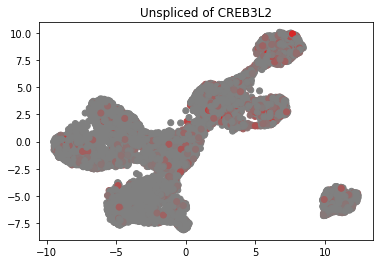

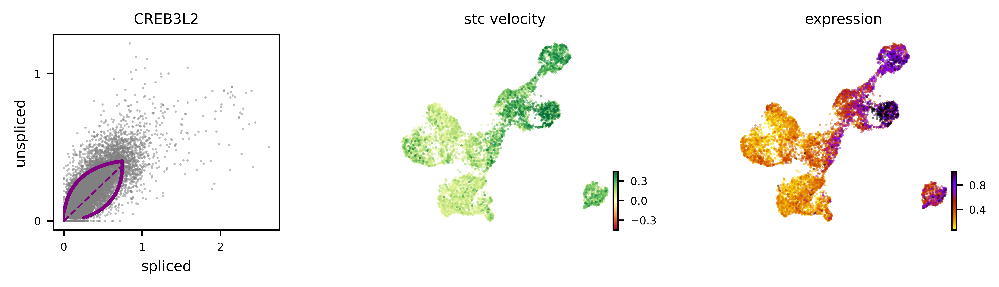

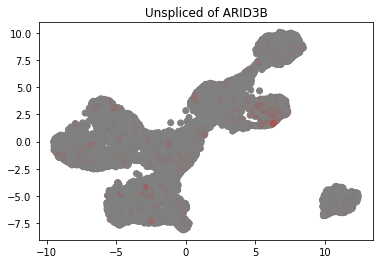

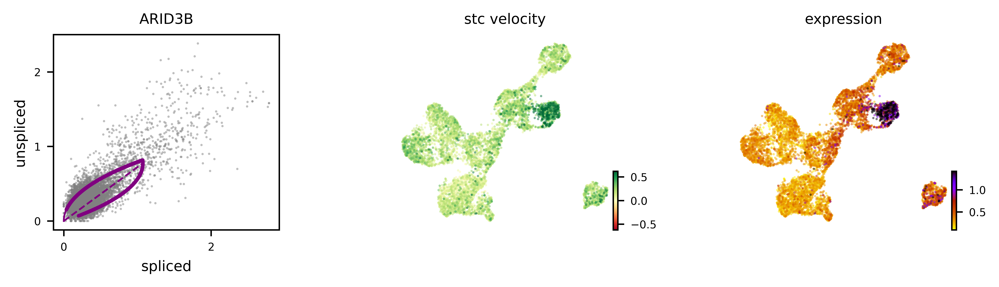

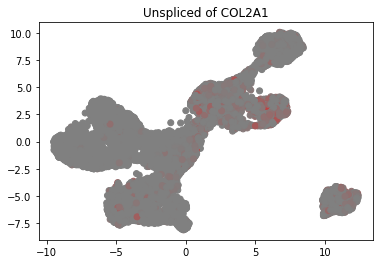

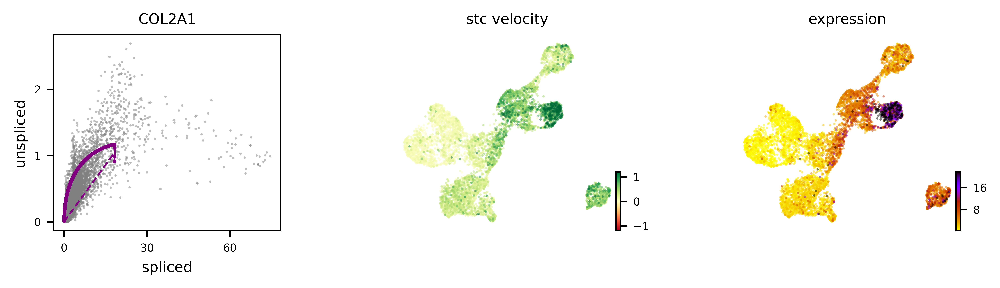

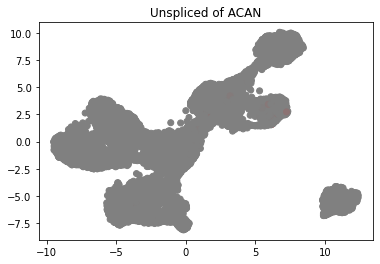

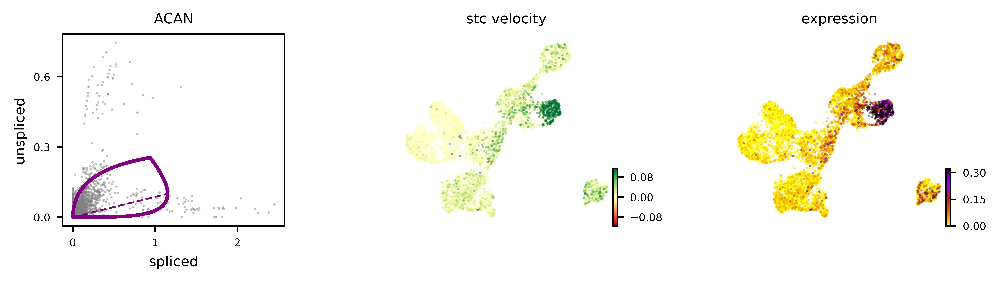

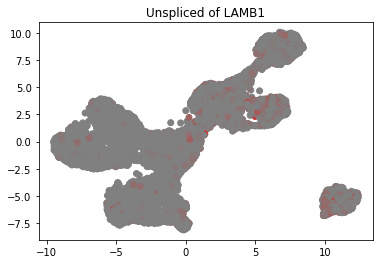

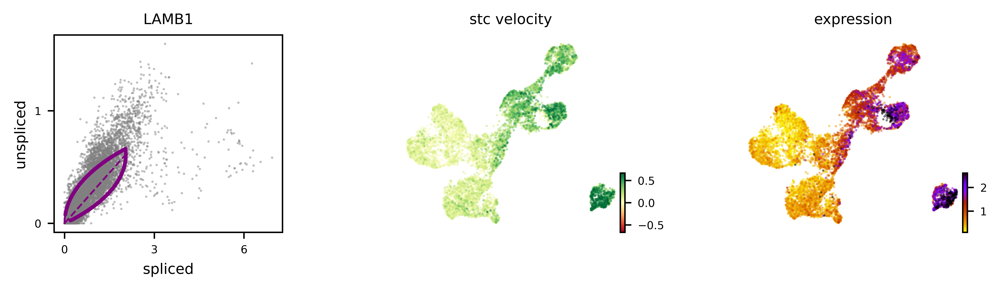

In [5]:
colorlist=["gray", "red"]
newcmp = LinearSegmentedColormap.from_list('testCmap', colors=colorlist, N=256)
for gene in plot_genes:
    plt.scatter(unsplicedDF['UMAP1'], unsplicedDF['UMAP2'], c = unsplicedDF[gene], cmap=newcmp)
    plt.title("Unspliced of " + gene)
    plt.savefig('/home/linxy29/holab/iPSC/veloAE/figures/' + sample + '_velocitygenes1_' + gene + '.png')
    scv.pl.velocity(adata, gene, vkey='stc_velocity', ncols=1, dpi = 900, save = '/home/linxy29/holab/iPSC/veloAE/figures/' + sample + '_velocitygenes2_' + gene + '.png')

In [ ]:
scv.pl.velocity(adata, plot_genes, vkey='stc_velocity', ncols=1, dpi = 900, save = '/home/linxy29/holab/iPSC/veloAE/figures/' + sample + '_' + 'velocitygenes.png')

saving figure to file /home/linxy29/holab/iPSC/veloAE/figures/day7_velocitygenes.png


## calculate pseudo time

In [3]:
#print(adata.obs.seurat_clusters.unique())
root_cell = ['Primitive streak (cluster4)', 'Primitive streak (cluster3)', 'Neuromesodermal progenitors']
## define root cell for latent time calculation
scv.tl.recover_dynamics(adata)

  0%|          | 0/417 [00:00<?, ?gene/s]

In [4]:
adata.write('/home/linxy29/holab/iPSC/veloAE/' + sample + '_seurate_wTrajectory.h5ad')

In [5]:
## define root key: Neuromesodermal progenitors is root cells
adata.obs['root_cell'] = np.where(adata.obs['seurat_clusters'] == 'Neuromesodermal progenitors', 1, 0)
scv.tl.latent_time(adata, root_key = 'Primitive streak')
print(adata)
## calculate the mean of latent time 
mean_latent_time = adata.obs.groupby('seurat_clusters')['latent_time'].mean()
print(mean_latent_time)

  0%|          | 0/9462 [00:00<?, ?cells/s]

AnnData object with n_obs × n_vars = 9462 × 2000
    obs: 'Clusters', '_X', '_Y', 'seurat_clusters', 'initial_size_spliced', 'initial_size_unspliced', 'initial_size', 'n_counts', 'stc_velocity_self_transition', 'stc_velocity_length', 'stc_velocity_confidence', 'stc_velocity_confidence_transition', 'root_cell', 'velocity_self_transition', 'root_cells', 'end_points', 'velocity_pseudotime', 'latent_time'
    var: 'Accession', 'Chromosome', 'End', 'Start', 'Strand', 'gene_count_corr', 'means', 'dispersions', 'dispersions_norm', 'highly_variable', 'stc_velocity_gamma', 'stc_velocity_qreg_ratio', 'stc_velocity_r2', 'stc_velocity_genes', 'spearmans_score', 'velocity_score', 'fit_r2', 'fit_alpha', 'fit_beta', 'fit_gamma', 'fit_t_', 'fit_scaling', 'fit_std_u', 'fit_std_s', 'fit_likelihood', 'fit_u0', 'fit_s0', 'fit_pval_steady', 'fit_steady_u', 'fit_steady_s', 'fit_variance', 'fit_alignment_scaling', 'velocity_gamma', 'velocity_qreg_ratio', 'velocity_r2', 'velocity_genes'
    uns: 'neighbors', 

In [4]:
adata.write('/home/linxy29/holab/iPSC/veloAE/' + sample + '_seurate_wTrajectory.h5ad')

seurat_clusters
Axial progenitors                        0.377013
Cardiac mesoderm                         0.514361
Endoderm                                 0.603972
Lateral/paraxial mesoderm progenitors    0.478894
Neuroectoderm                            0.428959
Neuromesodermal progenitors              0.479394
Notochord                                0.547739
Primitive streak (cluster3)              0.550990
Primitive streak (cluster4)              0.537886
Name: latent_time, dtype: float64

## plot velocity

In [3]:
setalpha = 0.7
alphaidx = 3
parser = get_parser()
args = parser.parse_args(args=['--lr', '1e-5', 
                               '--n-epochs', '20000', 
                               '--g-rep-dim', '100',
                               '--k-dim', '100',
                               '--model-name', 'dentategyrus_model.cpt',
                               '--exp-name', 'CohAE_dentategyrus',
                               '--device', 'cuda:2',
                               '--gumbsoft_tau', '5',
                               '--nb_g_src', "X",
                               '--ld_nb_g_src', "X",
                               '--n_raw_gene', '2000',
                               '--n_conn_nb', '30',
                               '--n_nb_newadata', '30',
                               '--aux_weight', '1',
                               '--fit_offset_train', 'false',
                               '--fit_offset_pred', 'true',
                               '--use_offset_pred', 'false',
                               '--gnn_layer', 'GAT',
                               '--vis-key', 'X_umap',
                               '--vis_type_col', 'seurat_clusters',
                               '--scv_n_jobs', '10',
                              ])
args 

Namespace(adata=None, aux_weight=1.0, conv_thred=1e-06, data_dir=None, device='cuda:2', exp_name='CohAE_dentategyrus', fit_offset_pred=True, fit_offset_train=False, g_rep_dim=100, gnn_layer='GAT', gumbsoft_tau=5.0, h_dim=256, is_half=False, k_dim=100, ld_adata='projection.h5', ld_nb_g_src='X', log_interval=100, lr=1e-05, lr_decay=0.9, mask_cluster_list=None, model_name='dentategyrus_model.cpt', n_conn_nb=30, n_epochs=20000, n_nb_newadata=30, n_raw_gene=2000, nb_g_src='X', output='./', pos_thred=0.01, pos_weight=0.0, refit=True, scv_n_jobs=10, seed=42, sl1_beta=1.0, use_norm=False, use_offset_pred=False, use_x=False, v_rg_wt=0.0, vis_key='X_umap', vis_type_col='seurat_clusters', weight_decay=0.0, z_dim=100)

In [4]:
from matplotlib.colors import ListedColormap
color_dict = {
    "Axial progenitors": "#EE9A00",
    "Axial/neuromesodermal progenitors": "#6cb4ef",
    "Cardiac mesoderm": "#CD5C5C",
    "Endoderm": "#BDB76B",
    "Homeostasis/stress": "#ffe5a5",
    "Paraxial mesoderm": "#fa6616",
    "Paraxial mesoderm progenitors": "#FF6347",
    "Lateral/paraxial mesoderm progenitors": "#FF6347",
    "Neuroectoderm": "#104E8B",
    "Neurectoderm": "#104E8B",
    "Neuromesodermal progenitors": "#5CACEE",
    "Notochord": "#008B00",
    "Primitive streak (cluster3)": "#666666",
    "Primitive streak (cluster4)": "#8B8B83",
    "Primitive streak-1": "#666666",
    "Primitive streak-2": "#8B8B83",
    "Primitive streak": "#666666"
}
print(adata.obs[args.vis_type_col].cat.categories)
## generate color_vect based on the adata.obs[args.vis_type_col].cat.categories
celltypeL = [celltype.replace("_", " ") for celltype in adata.obs[args.vis_type_col].cat.categories]
print(celltypeL)
color_vect = [color_dict[celltype] for celltype in celltypeL]
#color_vect = ["#EE9A00","#CD5C5C","#BDB76B","#FF6347","#104E8B","#5CACEE","#008B00","#666666","#8B8B83"]
print(color_vect)

Index(['Axial progenitors', 'Cardiac mesoderm', 'Endoderm',
       'Lateral/paraxial mesoderm progenitors', 'Neuroectoderm',
       'Neuromesodermal progenitors', 'Notochord',
       'Primitive streak (cluster3)', 'Primitive streak (cluster4)'],
      dtype='object')
['Axial progenitors', 'Cardiac mesoderm', 'Endoderm', 'Lateral/paraxial mesoderm progenitors', 'Neuroectoderm', 'Neuromesodermal progenitors', 'Notochord', 'Primitive streak (cluster3)', 'Primitive streak (cluster4)']
['#EE9A00', '#CD5C5C', '#BDB76B', '#FF6347', '#104E8B', '#5CACEE', '#008B00', '#666666', '#8B8B83']


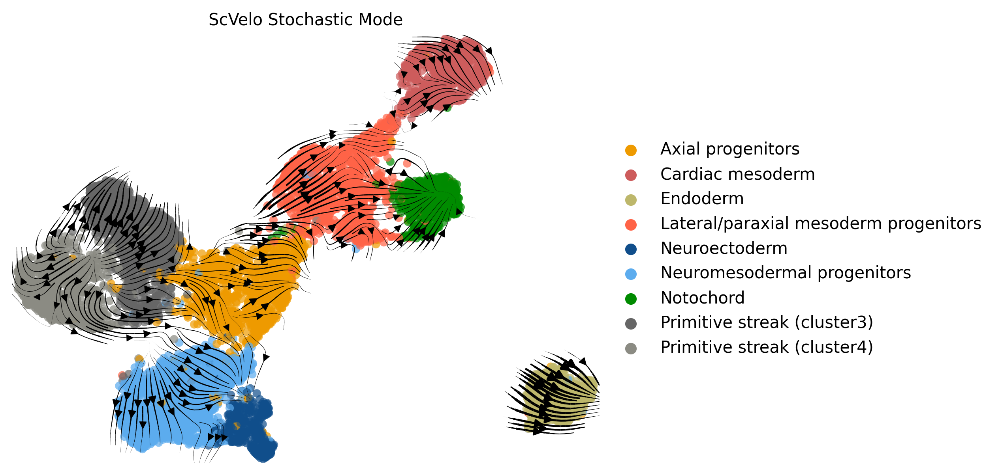

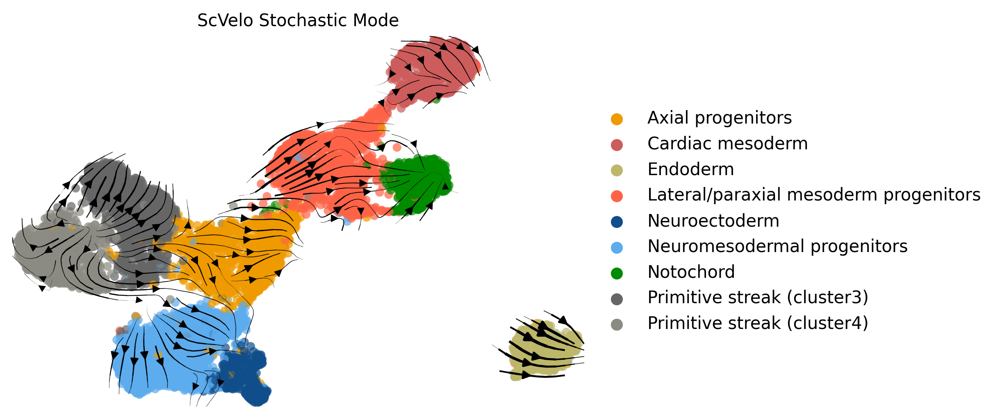

In [5]:
scv.pl.velocity_embedding_stream(adata, density = 4,  legend_loc="right margin", vkey="stc_velocity", basis=args.vis_key, color=args.vis_type_col, palette=color_vect, alpha = setalpha,
                                 dpi=300, title='ScVelo Stochastic Mode', save = '/home/linxy29/holab/iPSC/veloAE/' + sample + '_scVelo_definedColor_arrow2_tran' + str(alphaidx) +'.png')
scv.pl.velocity_embedding_stream(adata,  legend_loc="right margin", vkey="stc_velocity", basis=args.vis_key, color=args.vis_type_col, palette=color_vect, alpha = setalpha,
                                 dpi=300, title='ScVelo Stochastic Mode', save = '/home/linxy29/holab/iPSC/veloAE/' + sample + '_scVelo_definedColor_arrow1_tran' + str(alphaidx) +'.png')

In [6]:
scv.pl.velocity_embedding_stream(adata, legend_loc='right_margin', vkey="new_velocity", basis=args.vis_key, color=[args.vis_type_col],
                                    title="Project Original Velocity into Low-Dim Space (veloAE)", smooth=0.5,
                                    dpi=300, palette=color_vect, alpha = setalpha, 
                                    save='/home/linxy29/holab/iPSC/veloAE/' + sample + '_veloAE_definedColor_arrow1_tran' + str(alphaidx) +'.png')
    scv.pl.velocity_embedding_stream(adata, legend_loc='right_margin', vkey="new_velocity", basis=args.vis_key, color=[args.vis_type_col],
                                    title="Project Original Velocity into Low-Dim Space (veloAE)", smooth=0.5,
                                    dpi=300, palette=color_vect, density = 4, alpha = setalpha, 
                                    save='/home/linxy29/holab/iPSC/veloAE/' + sample + '_veloAE_definedColor_arrow2_tran' + str(alphaidx) +'.png')

IndentationError: unexpected indent (1988443886.py, line 5)